In [ ]:
import os
import re
import json
import time
import random
import zipfile
import numpy as np
import pandas as pd
import cv2
import torch
import torch.nn as nn
import torchvision.transforms as T
import timm
from pathlib import Path
from PIL import Image
from dataclasses import dataclass
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
from sklearn.metrics import f1_score, classification_report, confusion_matrix, roc_auc_score
from sklearn.model_selection import GroupShuffleSplit
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive


Target: 149 Normal images.
Found 143 images to plot.
Displaying images with 65% Zoom applied...


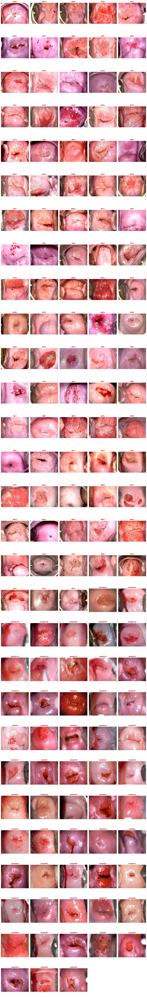

In [ ]:
import os
import re
import math
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

# --- CONFIGURATION ---
IMG_DIR = "/content/drive/MyDrive/MLProject/via_dataset"
CSV_PATH = "/content/drive/MyDrive/MLProject/labels_combine.csv"
ZOOM_FACTOR = 0.65  # Keep center 80%

# --- AUTOZOOM CLASS ---
class AutoZoom(object):
    def __init__(self, keep_percent=0.8):
        self.keep_percent = keep_percent

    def __call__(self, img):
        w, h = img.size
        new_w = int(w * self.keep_percent)
        new_h = int(h * self.keep_percent)

        left = (w - new_w) / 2
        top = (h - new_h) / 2
        right = (w + new_w) / 2
        bottom = (h + new_h) / 2

        return img.crop((left, top, right, bottom))

def plot_zoomed_precancer():
    # 1. Verify Paths
    if not os.path.exists(IMG_DIR) or not os.path.exists(CSV_PATH):
        print("Error: Image folder or CSV not found.")
        return

    # 2. Load CSV & Filter
    df = pd.read_csv(CSV_PATH)
    df['label'] = df['label'].astype(str).str.strip().str.capitalize()

    precancer_df = df[df['label'] == 'Normal']
    target_filenames = set(precancer_df['filename'].values)

    print(f"Target: {len(target_filenames)} Normal images.")

    # 3. Scan Directory
    found_images = []
    all_files = os.listdir(IMG_DIR)

    for f in all_files:
        if not f.lower().endswith('.jpg'): continue

        if f in target_filenames:
            # Extract ID for title
            clean_name = Path(f).stem
            if "IARC" in clean_name:
                match = re.search(r"([0-9]+[A-Z]+|[A-Z]+[0-9]+)", clean_name)
                pid = match.group(0) if match else "Unknown"
            elif "sample" in clean_name:
                pid = clean_name.split('_')[0]
            else:
                pid = clean_name

            found_images.append({'path': os.path.join(IMG_DIR, f), 'id': pid})

    print(f"Found {len(found_images)} images to plot.")

    # 4. Plotting
    if not found_images: return

    # Sort for consistency
    found_images.sort(key=lambda x: x['id'])

    # Grid setup
    num_imgs = len(found_images)
    cols = 5
    rows = math.ceil(num_imgs / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3.5 * rows))
    if num_imgs == 1: axes = [axes]
    else: axes = axes.flatten()

    # Initialize Zoomer
    zoomer = AutoZoom(keep_percent=ZOOM_FACTOR)

    print(f"Displaying images with {int(ZOOM_FACTOR*100)}% Zoom applied...")

    for i, item in enumerate(found_images):
        try:
            img = Image.open(item['path'])

            # APPLY ZOOM HERE
            img_zoomed = zoomer(img)

            axes[i].imshow(img_zoomed)
            axes[i].set_title(item['id'], fontsize=10, fontweight='bold', color='darkred')
            axes[i].axis('off')
        except Exception as e:
            print(f"Error: {e}")

    # Hide empty slots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

plot_zoomed_precancer()

In [ ]:
import os
import shutil
from google.colab import drive

# 1. Setup Paths
drive.mount('/content/drive')

# Configuration
SOURCE_DIR = "/content/drive/MyDrive/MLProject/via_dataset"
DEST_DIR = "/content/drive/MyDrive/MLProject/cleaned_via_dataset"

# Consolidated Exclusion List (Previous + New)
# I combined your previous list with the new IDs (ACR, ACY, etc.)
raw_exclusions = """
AAI1 ABX1 ACC1 ACP1 AEF1 sample111 sample91
AAG1 ACR ACY ADP ADU AFL AFJ AGV AGO AGB AHR AHS AJE
"""
EXCLUSION_LIST = raw_exclusions.split()

def create_cleaned_dataset():
    # 2. Prepare Destination (Wipe and Recreate)
    if os.path.exists(DEST_DIR):
        print(f"Removing old directory: {DEST_DIR}")
        shutil.rmtree(DEST_DIR)

    os.makedirs(DEST_DIR)
    print(f"Created new empty directory: {DEST_DIR}")

    # 3. Iterate and Filter
    all_files = os.listdir(SOURCE_DIR)
    print(f"Scanning {len(all_files)} files in source...")

    copied_count = 0
    excluded_count = 0

    for filename in all_files:
        if not filename.lower().endswith('.jpg'):
            continue

        # Check against Exclusion List
        is_excluded = False
        for bad_id in EXCLUSION_LIST:
            # Substring match handles both specific files (AAG1) and general IDs (ACR)
            if bad_id in filename:
                is_excluded = True
                print(f"Excluding: {filename} (Matches '{bad_id}')")
                break

        if is_excluded:
            excluded_count += 1
        else:
            # Copy valid file
            src_path = os.path.join(SOURCE_DIR, filename)
            dst_path = os.path.join(DEST_DIR, filename)
            shutil.copy2(src_path, dst_path)
            copied_count += 1

    # 4. Summary
    print("-" * 30)
    print(f"Process Complete.")
    print(f"Files Scanned: {len(all_files)}")
    print(f"Files Removed: {excluded_count}")
    print(f"Files Copied to Cleaned Folder: {copied_count}")
    print("-" * 30)

create_cleaned_dataset()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Created new empty directory: /content/drive/MyDrive/MLProject/cleaned_via_dataset
Scanning 297 files in source...
Excluding: IARC_image_bank_AHR1.jpg (Matches 'AHR')
Excluding: IARC_image_bank_AFL1.jpg (Matches 'AFL')
Excluding: IARC_image_bank_ADP1.jpg (Matches 'ADP')
Excluding: IARC_image_bank_AGO1.jpg (Matches 'AGO')
Excluding: IARC_image_bank_ACR1.jpg (Matches 'ACR')
Excluding: IARC_image_bank_ABX1.jpg (Matches 'ABX1')
Excluding: IARC_image_bank_ACC1.jpg (Matches 'ACC1')
Excluding: IARC_image_bank_AAI1.jpg (Matches 'AAI1')
Excluding: IARC_image_bank_ACY1.jpg (Matches 'ACY')
Excluding: IARC_image_bank_AGV1.jpg (Matches 'AGV')
Excluding: IARC_image_bank_AGB1.jpg (Matches 'AGB')
Excluding: IARC_image_bank_AFJ1.jpg (Matches 'AFJ')
Excluding: IARC_image_bank_AAG1.jpg (Matches 'AAG1')
Excluding: IARC_image_bank_ADU1.jpg (Matches 'ADU')
Excluding: IARC_image_ban

Target: 131 Precancerous images.
Found 126 images to plot.
Displaying images with 65% Zoom applied...


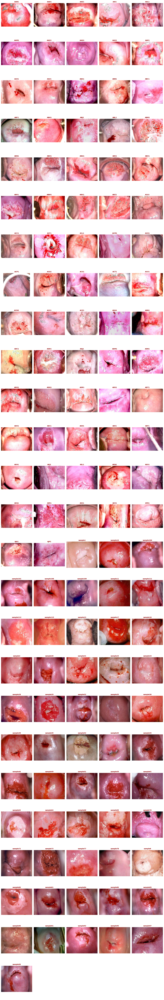

In [ ]:
import os
import re
import math
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

# --- CONFIGURATION ---
IMG_DIR = "/content/drive/MyDrive/MLProject/via_dataset"
CSV_PATH = "/content/drive/MyDrive/MLProject/labels_combine.csv"
ZOOM_FACTOR = 0.65  # Keep center 80%

# --- AUTOZOOM CLASS ---
class AutoZoom(object):
    def __init__(self, keep_percent=0.8):
        self.keep_percent = keep_percent

    def __call__(self, img):
        w, h = img.size
        new_w = int(w * self.keep_percent)
        new_h = int(h * self.keep_percent)

        left = (w - new_w) / 2
        top = (h - new_h) / 2
        right = (w + new_w) / 2
        bottom = (h + new_h) / 2

        return img.crop((left, top, right, bottom))

def plot_zoomed_precancer():
    # 1. Verify Paths
    if not os.path.exists(IMG_DIR) or not os.path.exists(CSV_PATH):
        print("Error: Image folder or CSV not found.")
        return

    # 2. Load CSV & Filter
    df = pd.read_csv(CSV_PATH)
    df['label'] = df['label'].astype(str).str.strip().str.capitalize()

    precancer_df = df[df['label'] == 'Precancerous']
    target_filenames = set(precancer_df['filename'].values)

    print(f"Target: {len(target_filenames)} Precancerous images.")

    # 3. Scan Directory
    found_images = []
    all_files = os.listdir(IMG_DIR)

    for f in all_files:
        if not f.lower().endswith('.jpg'): continue

        if f in target_filenames:
            # Extract ID for title
            clean_name = Path(f).stem
            if "IARC" in clean_name:
                match = re.search(r"([0-9]+[A-Z]+|[A-Z]+[0-9]+)", clean_name)
                pid = match.group(0) if match else "Unknown"
            elif "sample" in clean_name:
                pid = clean_name.split('_')[0]
            else:
                pid = clean_name

            found_images.append({'path': os.path.join(IMG_DIR, f), 'id': pid})

    print(f"Found {len(found_images)} images to plot.")

    # 4. Plotting
    if not found_images: return

    # Sort for consistency
    found_images.sort(key=lambda x: x['id'])

    # Grid setup
    num_imgs = len(found_images)
    cols = 5
    rows = math.ceil(num_imgs / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3.5 * rows))
    if num_imgs == 1: axes = [axes]
    else: axes = axes.flatten()

    # Initialize Zoomer
    zoomer = AutoZoom(keep_percent=ZOOM_FACTOR)

    print(f"Displaying images with {int(ZOOM_FACTOR*100)}% Zoom applied...")

    for i, item in enumerate(found_images):
        try:
            img = Image.open(item['path'])

            # APPLY ZOOM HERE
            img_zoomed = zoomer(img)

            axes[i].imshow(img_zoomed)
            axes[i].set_title(item['id'], fontsize=10, fontweight='bold', color='darkred')
            axes[i].axis('off')
        except Exception as e:
            print(f"Error: {e}")

    # Hide empty slots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

plot_zoomed_precancer()

Target: 26 Cancerous images.
Found 26 images to plot.
Displaying images with 65% Zoom applied...


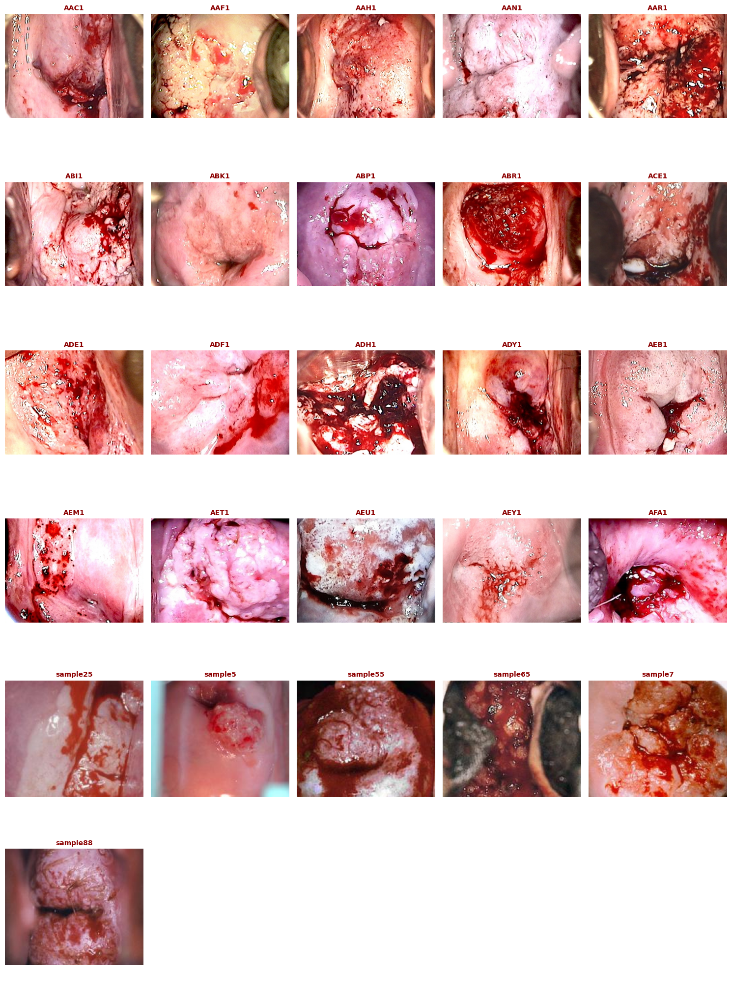

In [ ]:
import os
import re
import math
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

# --- CONFIGURATION ---
IMG_DIR = "/content/drive/MyDrive/MLProject/via_dataset"
CSV_PATH = "/content/drive/MyDrive/MLProject/labels_combine.csv"
ZOOM_FACTOR = 0.65  # Keep center 80%

# --- AUTOZOOM CLASS ---
class AutoZoom(object):
    def __init__(self, keep_percent=0.8):
        self.keep_percent = keep_percent

    def __call__(self, img):
        w, h = img.size
        new_w = int(w * self.keep_percent)
        new_h = int(h * self.keep_percent)

        left = (w - new_w) / 2
        top = (h - new_h) / 2
        right = (w + new_w) / 2
        bottom = (h + new_h) / 2

        return img.crop((left, top, right, bottom))

def plot_zoomed_precancer():
    # 1. Verify Paths
    if not os.path.exists(IMG_DIR) or not os.path.exists(CSV_PATH):
        print("Error: Image folder or CSV not found.")
        return

    # 2. Load CSV & Filter
    df = pd.read_csv(CSV_PATH)
    df['label'] = df['label'].astype(str).str.strip().str.capitalize()

    precancer_df = df[df['label'] == 'Cancerous']
    target_filenames = set(precancer_df['filename'].values)

    print(f"Target: {len(target_filenames)} Cancerous images.")

    # 3. Scan Directory
    found_images = []
    all_files = os.listdir(IMG_DIR)

    for f in all_files:
        if not f.lower().endswith('.jpg'): continue

        if f in target_filenames:
            # Extract ID for title
            clean_name = Path(f).stem
            if "IARC" in clean_name:
                match = re.search(r"([0-9]+[A-Z]+|[A-Z]+[0-9]+)", clean_name)
                pid = match.group(0) if match else "Unknown"
            elif "sample" in clean_name:
                pid = clean_name.split('_')[0]
            else:
                pid = clean_name

            found_images.append({'path': os.path.join(IMG_DIR, f), 'id': pid})

    print(f"Found {len(found_images)} images to plot.")

    # 4. Plotting
    if not found_images: return

    # Sort for consistency
    found_images.sort(key=lambda x: x['id'])

    # Grid setup
    num_imgs = len(found_images)
    cols = 5
    rows = math.ceil(num_imgs / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3.5 * rows))
    if num_imgs == 1: axes = [axes]
    else: axes = axes.flatten()

    # Initialize Zoomer
    zoomer = AutoZoom(keep_percent=ZOOM_FACTOR)

    print(f"Displaying images with {int(ZOOM_FACTOR*100)}% Zoom applied...")

    for i, item in enumerate(found_images):
        try:
            img = Image.open(item['path'])

            # APPLY ZOOM HERE
            img_zoomed = zoomer(img)

            axes[i].imshow(img_zoomed)
            axes[i].set_title(item['id'], fontsize=10, fontweight='bold', color='darkred')
            axes[i].axis('off')
        except Exception as e:
            print(f"Error: {e}")

    # Hide empty slots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

plot_zoomed_precancer()

In [ ]:
# ==============================================================================
# NOTEBOOK 1: AUGMENTING THE CLEANED DATASET (DYNAMIC RATIO 1.5:1:0.8)
# ==============================================================================

import os
import shutil
import random
import re
import cv2
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from google.colab import drive # Uncomment if running in Colab

# 1. Setup Paths
drive.mount('/content/drive') # Uncomment if running in Colab

# --- CONFIGURATION ---
# Adjust these paths to match your environment
CSV_PATH = "/content/drive/MyDrive/MLProject/labels_combine.csv"
SOURCE_IMG_DIR = "/content/drive/MyDrive/MLProject/cleaned_via_dataset"

# New Temp Directory
BASE_DIR = '/content/via_dataset_cleaned_processed'
TRAIN_DIR = os.path.join(BASE_DIR, 'train')
TEST_DIR = os.path.join(BASE_DIR, 'test')

# RATIO CONFIGURATION: Precancerous (1.5) : Cancerous (1.0) : Normal (0.8)
TARGET_RATIOS = {
    'Precancerous': 1.5,
    'Cancerous': 1.0,
    'Normal': 0.8
}
# We set the "1.0" unit to be approximately 2000 images.
# This implies: Precancerous ~3000, Normal ~1600.
UNIT_SIZE = 2000

# ---------------------

def main():
    # 2. COMPLETE CLEANUP
    print(f"Cleaning up {BASE_DIR}...")
    if os.path.exists(BASE_DIR):
        shutil.rmtree(BASE_DIR)
    os.makedirs(TRAIN_DIR)
    os.makedirs(TEST_DIR)

    # 3. Load & Filter Data
    print(f"Loading metadata from: {CSV_PATH}")
    if not os.path.exists(CSV_PATH):
        print(f"CRITICAL ERROR: CSV file not found at {CSV_PATH}")
        return

    df = pd.read_csv(CSV_PATH)
    # Standardize labels
    df['label'] = df['label'].astype(str).str.strip().str.capitalize()

    # Identify files that actually exist in the cleaned folder
    print(f"Scanning {SOURCE_IMG_DIR} for valid files...")
    if not os.path.exists(SOURCE_IMG_DIR):
        print(f"CRITICAL ERROR: Source directory {SOURCE_IMG_DIR} does not exist!")
        return
    else:
        available_files = set(os.listdir(SOURCE_IMG_DIR))
        print(f"Found {len(available_files)} files in cleaned directory.")

        # Filter Dataframe to only include existing files
        df = df[df['filename'].isin(available_files)]
        print(f"Filtered Dataframe size: {len(df)}")

    # 4. Patient Split
    # We define this helper to prevent data leakage (patient data shouldn't be in both train and test)
    def get_patient_id(filename):
        filename = str(filename).strip()
        # Pattern for IARC IDs
        if "IARC" in filename:
            match = re.search(r"([0-9]+[A-Z]+|[A-Z]+[0-9]+)", filename)
            if match: return match.group(0)
        # Pattern for generic samples
        if "sample" in filename:
            return filename.split('_')[0]
        return filename

    df['patient_id'] = df['filename'].apply(get_patient_id)
    unique_patients = df['patient_id'].unique()

    train_patients, test_patients = train_test_split(unique_patients, test_size=0.2, random_state=42)
    print(f"Train Patients: {len(train_patients)} | Test Patients: {len(test_patients)}")

    # 5. Move Originals
    filename_to_label = dict(zip(df['filename'], df['label']))

    def move_files(patient_list, destination):
        count_map = {'Precancerous': 0, 'Cancerous': 0, 'Normal': 0}
        subset = df[df['patient_id'].isin(patient_list)]

        for _, row in subset.iterrows():
            fname = row['filename']
            label = row['label']
            src = os.path.join(SOURCE_IMG_DIR, fname)
            dst = os.path.join(destination, fname)

            if os.path.exists(src):
                shutil.copy2(src, dst)
                if label in count_map:
                    count_map[label] += 1
        return count_map

    print("Moving original files...")
    train_counts = move_files(train_patients, TRAIN_DIR)
    test_counts = move_files(test_patients, TEST_DIR)

    print("-" * 30)
    print(f"Originals in Train: {train_counts}")
    print(f"Originals in Test:  {test_counts}")
    print("-" * 30)

    # 6. DYNAMIC MULTIPLIER CALCULATION
    # We calculate how many copies we need per image to reach the target ratio
    multipliers = {}
    print("\nCalculating Augmentation Multipliers...")

    for label, ratio in TARGET_RATIOS.items():
        original_count = train_counts.get(label, 0)
        if original_count == 0:
            print(f"WARNING: No original images found for {label}. Cannot augment.")
            multipliers[label] = 0
            continue

        target_count = int(UNIT_SIZE * ratio)

        # Calculate how many NEW copies we need per original image
        # Total = Original + (Original * Multiplier)
        # Multiplier = (Total - Original) / Original
        needed = target_count - original_count
        if needed < 0: needed = 0

        mult = int(np.ceil(needed / original_count))
        multipliers[label] = mult

        print(f"  [{label}] Orig: {original_count} | Target: {target_count} | Multiplier: {mult}x (Total est: {original_count * (1+mult)})")

    # 7. AUGMENTATION LOGIC
    def generate_random_variant(image):
        h, w = image.shape[:2]
        aug_img = image.copy()

        # Rotate (-45 to 45)
        angle = random.uniform(-45, 45)
        M = cv2.getRotationMatrix2D((w//2, h//2), angle, 1.0)
        aug_img = cv2.warpAffine(aug_img, M, (w, h), borderMode=cv2.BORDER_REFLECT)

        # Flips
        if random.random() > 0.5: aug_img = cv2.flip(aug_img, 1)
        if random.random() > 0.5: aug_img = cv2.flip(aug_img, 0)

        # Color/Contrast
        if random.random() > 0.3:
            alpha = random.uniform(0.8, 1.2)
            beta = random.uniform(-20, 20)
            aug_img = cv2.convertScaleAbs(aug_img, alpha=alpha, beta=beta)

        return aug_img

    print("\nStarting Augmentation Process...")
    train_files_list = [f for f in os.listdir(TRAIN_DIR) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]

    augmented_count = 0

    for fname in train_files_list:
        img_path = os.path.join(TRAIN_DIR, fname)
        image = cv2.imread(img_path)
        if image is None: continue

        label = filename_to_label.get(fname, "Unknown")

        # Get the calculated dynamic multiplier
        num_copies = multipliers.get(label, 0)

        base_name = os.path.splitext(fname)[0]

        for i in range(num_copies):
            aug_variant = generate_random_variant(image)
            save_name = f"{base_name}_aug_{i}.jpg"
            save_path = os.path.join(TRAIN_DIR, save_name)
            cv2.imwrite(save_path, aug_variant)
            augmented_count += 1

    # 8. Final Stats & Zip
    final_files = os.listdir(TRAIN_DIR)
    final_counts = {'Precancerous': 0, 'Cancerous': 0, 'Normal': 0, 'Unknown': 0}

    # Quick count of final directory based on original filenames map
    # Note: Augmented files usually start with original filename
    for f in final_files:
        # Heuristic to find original label from augmented filename
        # Assumes format "OriginalName_aug_X.jpg" or "OriginalName.jpg"
        original_key = f
        if "_aug_" in f:
            original_key = f.split("_aug_")[0] + ".jpg" # Attempt reconstruction
            # If extension was different, we might miss it, but filename_to_label logic handles exact keys
            # Let's try to match loosely by base name if strict match fails

        lbl = filename_to_label.get(original_key)
        if not lbl:
             # Try stripping extension
             base = f.split("_aug_")[0]
             for k, v in filename_to_label.items():
                 if k.startswith(base):
                     lbl = v
                     break

        if lbl in final_counts:
            final_counts[lbl] += 1
        else:
            final_counts['Unknown'] += 1

    print("-" * 30)
    print(f"Augmentation Finished.")
    print(f"New Augmentations Created: {augmented_count}")
    print(f"FINAL TRAIN DISTRIBUTION (Approx):")
    for k, v in final_counts.items():
        print(f"  {k}: {v}")
    print("-" * 30)

    zip_name = '/content/drive/MyDrive/MLProject/Cleaned_Dataset_Processed'
    print(f"Zipping dataset to {zip_name}.zip...")
    shutil.make_archive(zip_name, 'zip', BASE_DIR)
    print("Done.")

if __name__ == "__main__":
    main()

Mounted at /content/drive
Cleaning up /content/via_dataset_cleaned_processed...
Loading metadata from: /content/drive/MyDrive/MLProject/labels_combine.csv
Scanning /content/drive/MyDrive/MLProject/cleaned_via_dataset for valid files...
Found 276 files in cleaned directory.
Filtered Dataframe size: 275
Train Patients: 220 | Test Patients: 55
Moving original files...
------------------------------
Originals in Train: {'Precancerous': 104, 'Cancerous': 20, 'Normal': 96}
Originals in Test:  {'Precancerous': 15, 'Cancerous': 6, 'Normal': 34}
------------------------------

Calculating Augmentation Multipliers...
  [Precancerous] Orig: 104 | Target: 3000 | Multiplier: 28x (Total est: 3016)
  [Cancerous] Orig: 20 | Target: 2000 | Multiplier: 99x (Total est: 2000)
  [Normal] Orig: 96 | Target: 1600 | Multiplier: 16x (Total est: 1632)

Starting Augmentation Process...
------------------------------
Augmentation Finished.
New Augmentations Created: 6428
FINAL TRAIN DISTRIBUTION (Approx):
  Preca